In [3]:
## initial attempts for graph visualizations and manips

In [4]:
import os
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import holoviews, pygraphviz
import networkx as nx
import pandas as pd
import matplotlib.patches as mpatches
from scipy import stats

In [5]:
#import pylab as plt

In [6]:
print(os.getcwd())

/home/bioinfo/bulk_analysis/graphmodeling


In [7]:
myroot = "~/bulk_analysis/"

print(os.getcwd())
natmiVizOut = "natmiD7/Network_exp_0_spe_0_det_0.2_top_0_signal_lrc2p_weight_mean/"
tb = pd.read_csv(f'{myroot}{natmiVizOut}Edges.csv',sep=",", header=0)
tb.head()

/home/bioinfo/bulk_analysis/graphmodeling


,Sending cluster,Ligand symbol,Receptor symbol,Target cluster,Ligand detection rate,Ligand average expression value,Ligand derived specificity of average expression value,Receptor detection rate,Receptor average expression value,Receptor derived specificity of average expression value,Edge average expression weight,Edge average expression derived specificity
0,sCs,Agt,Mas1,ECs,1,0.277334,1.0,1,0.284201,0.073664,0.078819,0.073664
1,sCs,Agt,Mas1,FAPs,1,0.277334,1.0,1,2.742778,0.710923,0.760666,0.710923
2,sCs,Agt,Mas1,sCs,1,0.277334,1.0,1,0.831075,0.215413,0.230486,0.215413
3,sCs,Agt,Agtr1a,FAPs,1,0.277334,1.0,1,17.156118,0.696806,4.757978,0.696806
4,sCs,Agt,Agtr1a,sCs,1,0.277334,1.0,1,7.464964,0.303194,2.070290,0.303194


In [8]:
# make UNIQUE the ligand and receptor names by combining celltype alongside
tb['uniq_Ligand_symbol'] = tb['Ligand symbol'] + tb['Sending cluster']
tb['uniq_Receptor_symbol'] = tb['Receptor symbol'] + tb['Target cluster']

### minimal test defining only one fictional interaction

In [9]:
T = nx.DiGraph(age_day="Young_D7")
T.add_node('mooA', celltype = 'A', genesym = 'uuu', color='#73D055FF',specif=0.00001)
T.add_node('mooB', celltype= 'B', genesym = 'uuu', color='#A0CBE2',specif=3000)
T.add_edge('mooA','mooB', origtype='A')
T.add_edge('mooA','mooA', origtype='A')


In [10]:
node_labels = nx.get_node_attributes(T,'genesym')

In [11]:
from networkx.drawing.nx_agraph import write_dot 
write_dot(T,'graph.dot')

In [12]:
# see this : https://pypi.org/project/network2tikz/
# https://medium.com/kenlok/how-to-draw-an-interactive-network-graph-using-dash-b6b744f60931

In [13]:
pos = nx.spring_layout(T)

In [14]:
sss = [ v for v in nx.get_node_attributes(T,'specif').values()]
nodes = T.nodes()

In [15]:
ccc = [nodes[n]['color'] for n in nodes]  

In [16]:
def treatverysmallv(i):
    if i < 1:
        return 1
    else:
        return i
kkk = [ treatverysmallv(i) for i in sss ]

In [17]:
kkk

[1, 3000]

{'mooA': Text(0.5849048229239787, 0.9999999999999999, 'uuu'),
 'mooB': Text(-0.5849048229239788, -1.0, 'uuu')}

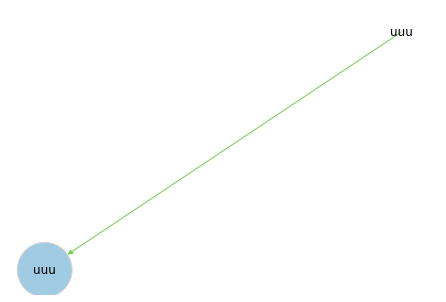

In [18]:
#caution: edgecolors is for vertex border :
nx.draw(T, pos, edge_color=ccc, node_color=ccc, node_size=kkk, node_shape='o', edgecolors='lightgray' )
nx.draw_networkx_labels(T, pos, labels=node_labels)
#nx.draw_networkx_nodes(G, pos,  node_color=ccc, node_size=sss, edgecolors=('red','blue'))


This minimal test allows to visualize two genes by COLOR celltype (arrow is same color as sending cell-type), here ligand has too little expression compared to 3000 times the receptor expression (circle radius). Labels here simulate same gene name but in different cell types.

## TOY DATASET

In [19]:
# extract a toy dataset to work with, random rows indeed:
toy = tb.sample(n=10)

In [20]:
toy.shape

(10, 14)

In [21]:
G = nx.DiGraph(age_day="Young_D7")

In [22]:
#celltycolors = {'FAPs':'#73D055FF', 'sCs':'#DFC27D', 'M1':'#E66101', 
 #                  'M2':'#5F9EA0', 'Neutro':'#b8627db2', 'ECs':'#13306db2'}

In [23]:
celltycolors = {'FAPs':'#5F9EA0' , 'sCs': '#DFC27D' , 'M1': '#13306db2', 
                   'M2': '#E66101', 'Neutro': '#73D055FF', 'ECs': '#b8627db2'}

In [24]:
for index, row in toy.iterrows():
    nodefrom = row['uniq_Ligand_symbol']
    nodeto = row['uniq_Receptor_symbol'] 
    celltypefrom = row['Sending cluster']
    celltypeto = row['Target cluster']
    print([nodefrom,nodeto])
    print(row['Ligand average expression value'])
    G.add_node(nodefrom, 
               celltype = celltypefrom, 
               genesym = row['Ligand symbol'], 
               color=celltycolors[celltypefrom],
               averagexp = row['Ligand average expression value'])
    G.add_node(nodeto, 
               celltype = celltypeto, 
               genesym = row['Receptor symbol'], 
               color = celltycolors[celltypeto],
               averagexp = row['Receptor average expression value'])
    G.add_edge(nodefrom,nodeto, origtype=nodefrom, ecolor=celltycolors[celltypefrom],weight = row['Edge average expression weight'])



['Slit1FAPs', 'Sdc1FAPs']
0.5328791133764221
['C3M2', 'Cd46ECs']
34.868273302174394
['Sema3fECs', 'Plxna3sCs']
4.73434643125623
['Tgfb1sCs', 'Tgfbr2FAPs']
14.442920243596301
['Il16sCs', 'Grin2dFAPs']
0.16126980350800102
['Sema6dsCs', 'Trem2M2']
19.8965226178398
['Cxcl12M2', 'Itgb1FAPs']
0.237343966245174
['Sema3bsCs', 'Nrp2sCs']
4.37747519912985
['Rspo3FAPs', 'Sdc4M2']
3.84911051206761
['Fgf2sCs', 'Gpc4sCs']
2.18791744350908


In [25]:
def treatverysmallv(i):
    if i < 1:
        return 1
    else:
        return i

In [26]:

nodes = G.nodes()
ccc = [nodes[n]['color'] for n in nodes]
#sss = [nodes[n]['averagexp'] for n in nodes]

node_exps = nx.get_node_attributes(G,'averagexp')
node_labels = nx.get_node_attributes(G,'genesym')


In [27]:
edges = G.edges()

In [28]:
eee = [edges[ed]['ecolor'] for ed in edges]

In [29]:
nodeexpressions = [i*10 for i in node_exps.values()]

In [30]:
np.mean(nodeexpressions)

214.91933345392914

{'Slit1FAPs': Text(0.734372650965667, -0.7241157547466924, 'Slit1'),
 'Sdc1FAPs': Text(-0.4908179519662598, 0.8929946917988988, 'Sdc1'),
 'C3M2': Text(0.3368410284027579, 0.8154617807641612, 'C3'),
 'Cd46ECs': Text(-0.9688343872041415, 0.07067260827786839, 'Cd46'),
 'Sema3fECs': Text(0.8834137701407915, -0.11390873091430942, 'Sema3f'),
 'Plxna3sCs': Text(-0.8762410945529233, -0.2139405841162625, 'Plxna3'),
 'Tgfb1sCs': Text(0.7790419844054766, 0.44613828082911877, 'Tgfb1'),
 'Tgfbr2FAPs': Text(0.12510547901049426, 1.0, 'Tgfbr2'),
 'Il16sCs': Text(-0.09346911537175816, -0.84874721827005, 'Il16'),
 'Grin2dFAPs': Text(0.1888180495572177, -0.9255986126415413, 'Grin2d'),
 'Sema6dsCs': Text(0.4636509865329439, -0.7450117358952801, 'Sema6d'),
 'Trem2M2': Text(-0.6655809660131058, -0.7794478600769331, 'Trem2'),
 'Cxcl12M2': Text(-0.8713952038971381, 0.3773026973382807, 'Cxcl12'),
 'Itgb1FAPs': Text(-0.7019162408612815, 0.6450882803052869, 'Itgb1'),
 'Sema3bsCs': Text(0.991830954752512, 0.22921

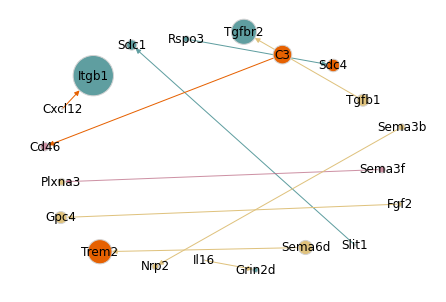

In [31]:
pos = nx.spring_layout(G, k=max(nodeexpressions))
nx.draw(G, pos, edge_color=eee, node_size=nodeexpressions, node_color=ccc, node_shape='o', edgecolors='lightgray' )
nx.draw_networkx_labels(G, pos, labels=node_labels)

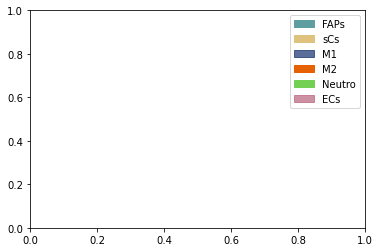

In [32]:
color_patches = []
for key, value in celltycolors.items():
    tmppatch = mpatches.Patch(color=value, label=key)
    color_patches.append(tmppatch)
    
plt.legend(handles=color_patches)
plt.show()

In [33]:
weights = [edges[ed]['weight'] for ed in edges]


In [34]:
from scipy import stats

In [35]:
tmp = np.array(weights)
centiles = [5,25,50,75,95]
cutoff_centile = [np.percentile(tmp,k) for k in centiles]
weightsranks = [stats.percentileofscore(weights, a, 'rank') for a in weights]

{'Slit1FAPs': Text(-0.18657773012942638, -0.894746532881811, 'Slit1'),
 'Sdc1FAPs': Text(0.8516853315804528, -0.48480951841804654, 'Sdc1'),
 'C3M2': Text(0.7911558569935416, 0.5014415801804042, 'C3'),
 'Cd46ECs': Text(0.3525333605724943, 0.9858725781100189, 'Cd46'),
 'Sema3fECs': Text(-0.5665644370307997, 0.7464394382358464, 'Sema3f'),
 'Plxna3sCs': Text(0.9770108469995799, -0.17504760802713448, 'Plxna3'),
 'Tgfb1sCs': Text(-0.48830608496019484, -0.7254364474845706, 'Tgfb1'),
 'Tgfbr2FAPs': Text(0.39369986915462696, -0.8599947224046159, 'Tgfbr2'),
 'Il16sCs': Text(-0.02976863474838234, 0.9062378788966229, 'Il16'),
 'Grin2dFAPs': Text(0.10532063243242085, -0.9766718349725819, 'Grin2d'),
 'Sema6dsCs': Text(0.13956902962056064, 0.018393630610302615, 'Sema6d'),
 'Trem2M2': Text(-0.4052213565816537, -0.7761700493782394, 'Trem2'),
 'Cxcl12M2': Text(-0.894077247536465, 0.6063261978685813, 'Cxcl12'),
 'Itgb1FAPs': Text(-0.8156169304774308, -0.3222669052611666, 'Itgb1'),
 'Sema3bsCs': Text(-0.9

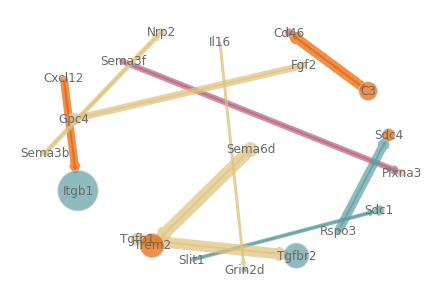

In [36]:
pos = nx.spring_layout(G, k=10)  # k I took it away as it rendered ugly
nx.draw(G, pos, edge_color=eee, node_size=nodeexpressions, 
        node_color=ccc, node_shape='o', 
        width=[i/10 for i in weightsranks],
        alpha=0.7, arrowstyle='simple',
        edgecolors='lightgray' )
nx.draw_networkx_labels(G, pos, 
                        labels=node_labels,
                       font_color='dimgray')



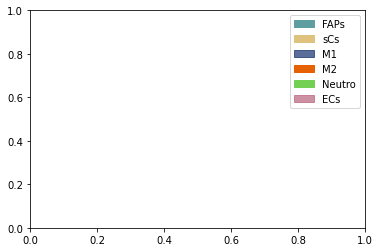

In [37]:
plt.legend(handles=color_patches)
plt.show()

In [38]:
# think about communities:
# https://stackoverflow.com/questions/43541376/how-to-draw-communities-with-networkx
# then search dash !!!  ****
# width edge: 
# https://stackoverflow.com/questions/25639169/networkx-change-color-width-according-to-edge-attributes-inconsistent-result
# think about aesthetics (if time)

In [39]:
# bigger toy:
toy2 = tb.sample(n=100)

In [40]:
G2 = nx.DiGraph()
for index, row in toy2.iterrows():
    nodefrom = row['uniq_Ligand_symbol']
    nodeto = row['uniq_Receptor_symbol'] 
    celltypefrom = row['Sending cluster']
    celltypeto = row['Target cluster']
    G2.add_node(nodefrom, 
               celltype = celltypefrom, 
               genesym = row['Ligand symbol'], 
               color=celltycolors[celltypefrom],
               averagexp = row['Ligand average expression value'])
    G2.add_node(nodeto, 
               celltype = celltypeto, 
               genesym = row['Receptor symbol'], 
               color = celltycolors[celltypeto],
               averagexp = row['Receptor average expression value'])
    G2.add_edge(nodefrom,nodeto, origtype=nodefrom, ecolor=celltycolors[celltypefrom],weight = row['Edge average expression weight'])



In [41]:
nodes = G2.nodes() 
edges = G2.edges()



In [42]:
len(nodes)

185

In [43]:
node_labels = nx.get_node_attributes(G2,'genesym')
nodeexpressions = [ i for i in nx.get_node_attributes(G2,'averagexp').values()]
ccc = [co for co in nx.get_node_attributes(G2,'color').values()]
weights =  [edges[ed]['weight'] for ed in edges]
tmp = np.array(weights)
centiles = [5,25,50,75,95]
cutoff_centile = [np.percentile(tmp,k) for k in centiles]
weightsranks = [stats.percentileofscore(weights, a, 'rank') for a in weights]

In [44]:
width=[(i+1)/10 for i in weightsranks],

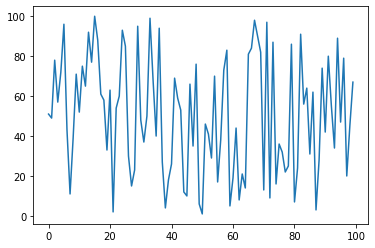

In [45]:
plt.plot(range(0,len(weightsranks)), weightsranks)
plt.show()  # too many different ranks !!! no useful for my purposes

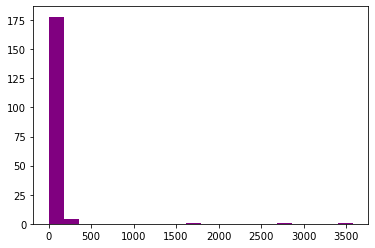

In [46]:
plt.hist(nodeexpressions, bins=20, color='purple')
plt.show()

<function matplotlib.pyplot.show(close=None, block=None)>

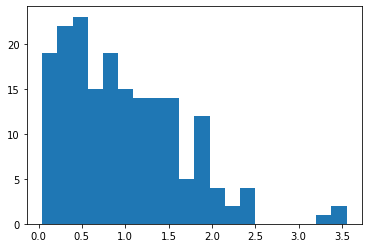

In [55]:
plt.hist(np.log10(np.array(nodeexpressions)+1), bins=20) 
plt.show #only for visualization purposes

<function matplotlib.pyplot.show(close=None, block=None)>

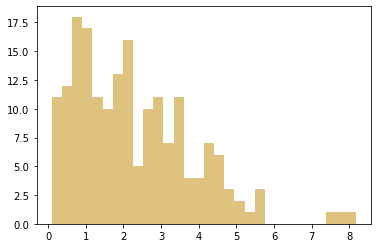

In [54]:
plt.hist(np.log(np.array(nodeexpressions)+1), bins=30, color='#DFC27D') 
plt.show #only for visualization purposes

In [78]:
pos = nx.random_layout(G2)  


{'Lrpap1sCs': Text(0.6138996, 0.3496289, 'Lrpap1'),
 'LdlrFAPs': Text(0.0856573, 0.5528603, 'Ldlr'),
 'Cxcl12sCs': Text(0.23938861, 0.9769174, 'Cxcl12'),
 'Itga4sCs': Text(0.6950543, 0.23477308, 'Itga4'),
 'Sema3bFAPs': Text(0.023854401, 0.19432811, 'Sema3b'),
 'Nrp2FAPs': Text(0.91395485, 0.7461017, 'Nrp2'),
 'Jag1ECs': Text(0.14424585, 0.5586134, 'Jag1'),
 'Notch2sCs': Text(0.5126625, 0.61825746, 'Notch2'),
 'Fbn1FAPs': Text(0.38011876, 0.19435896, 'Fbn1'),
 'Itga5M2': Text(0.337745, 0.2415857, 'Itga5'),
 'Sema6bECs': Text(0.49427065, 0.5251719, 'Sema6b'),
 'Plxna2FAPs': Text(0.4084974, 0.8154344, 'Plxna2'),
 'MdkM2': Text(0.5080839, 0.83888966, 'Mdk'),
 'Sdc4ECs': Text(0.31396008, 0.26089764, 'Sdc4'),
 'Ccl4M2': Text(0.80535245, 0.09791798, 'Ccl4'),
 'Ccr3M2': Text(0.23043773, 0.89213586, 'Ccr3'),
 'Il4sCs': Text(0.23959164, 0.38309994, 'Il4'),
 'Cd53M2': Text(0.627059, 0.09415689, 'Cd53'),
 'Jam3ECs': Text(0.64810455, 0.8810134, 'Jam3'),
 'Jam2FAPs': Text(0.81616235, 0.9175992, 'Ja

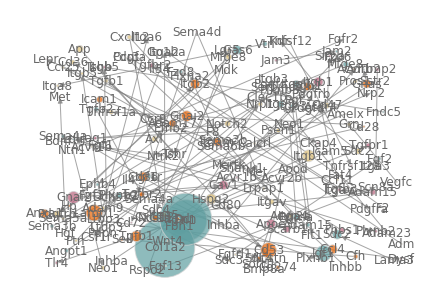

In [76]:
nx.draw(G2, pos, node_size=nodeexpressions,
        node_color=ccc, node_shape='o', 
        alpha=0.7, edge_color='gray',
        edgecolors='lightgray' )
nx.draw_networkx_labels(G, pos, 
                        labels=node_labels,
                       font_color='dimgray')

In [ ]:
##  https://networkx.org/documentation/stable/auto_examples/drawing/plot_directed.html

In [79]:
len(nodes)

185

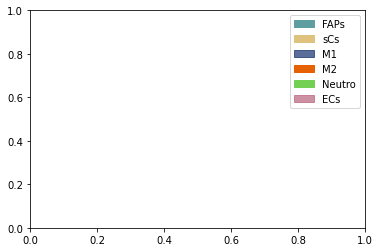

In [80]:
color_patches = []
for key, value in celltycolors.items():
    tmppatch = mpatches.Patch(color=value, label=key)
    color_patches.append(tmppatch)
    
plt.legend(handles=color_patches)
plt.show()

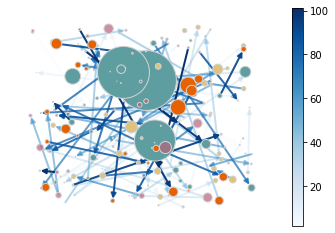

In [81]:
##  https://networkx.org/documentation/stable/auto_examples/drawing/plot_directed.html
M = G2.number_of_edges()
edge_colors = range(2,M + 2)
edge_alphas = [(5 + i) / (M + 4) for i in range(M)]
nodes = nx.draw_networkx_nodes(G2,
                              pos,
                              node_size = nodeexpressions,
                              node_color = ccc,
                              edgecolors='lightgray')
edges = nx.draw_networkx_edges(G2,pos,
                              node_size=nodeexpressions,
                              arrowsize=10,
                              edge_color=edge_colors,
                              edge_cmap=plt.cm.Blues,
                              width=2)

# set alpha val for each edge
for i in range(M):
    edges[i].set_alpha(edge_alphas[i])
pc = mpl.collections.PatchCollection(edges,cmap=plt.cm.Blues)
pc.set_array(edge_colors)
plt.colorbar(pc)
ax = plt.gca()
ax.set_axis_off()

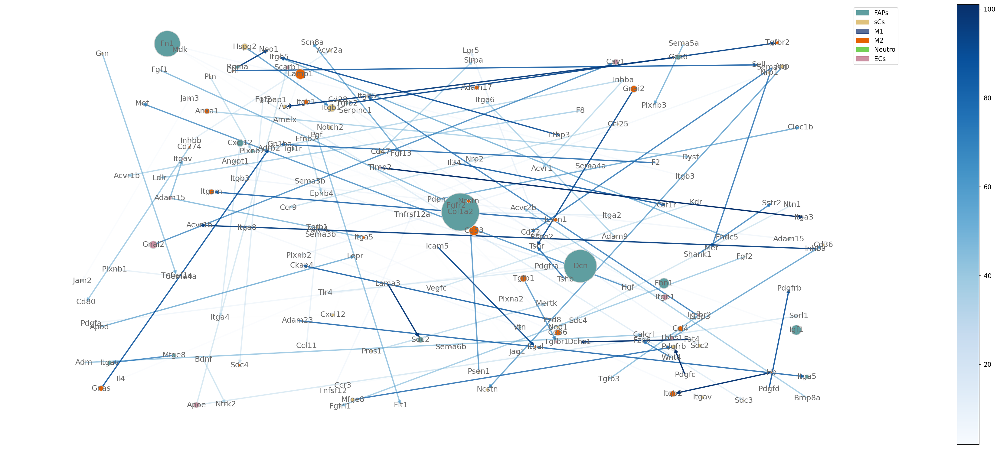

In [96]:
pos = nx.random_layout(G2)
M = G2.number_of_edges()
edge_colors = range(2,M + 2)
edge_alphas = [(5 + i) / (M + 4) for i in range(M)]

fig = plt.figure(figsize=(25,10),dpi=150)

color_patches = []
for key, value in celltycolors.items():
    tmppatch = mpatches.Patch(color=value, label=key)
    color_patches.append(tmppatch)
    
plt.legend(handles=color_patches)

nodes = nx.draw_networkx_nodes(G2,
                              pos,
                              node_size = nodeexpressions,
                              node_color = ccc,
                              edgecolors='lightgray')
edges = nx.draw_networkx_edges(G2,pos,
                              node_size=nodeexpressions,
                              arrowsize=10,
                              edge_color=edge_colors,
                              edge_cmap=plt.cm.Blues,
                              width=2)
nodelabels = nx.draw_networkx_labels(G2, pos, 
                        labels=node_labels,
                       font_color='dimgray')
# set alpha val for each edge
for i in range(M):
    edges[i].set_alpha(edge_alphas[i])
pc = mpl.collections.PatchCollection(edges,cmap=plt.cm.Blues)
pc.set_array(edge_colors)
plt.colorbar(pc)
ax = plt.gca()
ax.set_axis_off()

fig.tight_layout()
fig.savefig('hooooopeD.pdf',dpi=150)

###  finding patterns (test only for D7 Young)

In [97]:
# use entire graph Young D7 to extract 'connected components' (if any)

In [100]:
GY7 = nx.DiGraph()
for index,row in tb.iterrows():
    nodefrom = row['uniq_Ligand_symbol']
    nodeto = row['uniq_Receptor_symbol']
    celltypefrom = row['Sending cluster']
    celltypeto = row['Target cluster']
    GY7.add_node(nodefrom,
                celltype = celltypefrom,
                genesym = row['Ligand symbol'],
                color = celltycolors[celltypefrom],
                averagexp = row['Ligand average expression value'])
    GY7.add_node(nodeto,
                celltype = celltypeto, 
                genesym = row['Receptor symbol'],
                color = celltycolors[celltypeto],
                averagexp = row['Receptor average expression value'])
    GY7.add_edge(nodefrom,nodeto, origtype = nodefrom,
                ecolor = celltycolors[celltypefrom],
                weight = row['Edge average expression weight'])

In [104]:
nodes = GY7.nodes()
edges = GY7.edges()

In [125]:
print([GY7.number_of_nodes(), GY7.number_of_edges()] )  

[2009, 8796]


As we see, we have *in average* 4 edges for every single node.

In [114]:
ccc = [ co for co in nx.get_node_attributes(GY7, 'color').values()]
eee = [co for co in nx.get_edge_attributes(GY7, 'ecolor').values()]

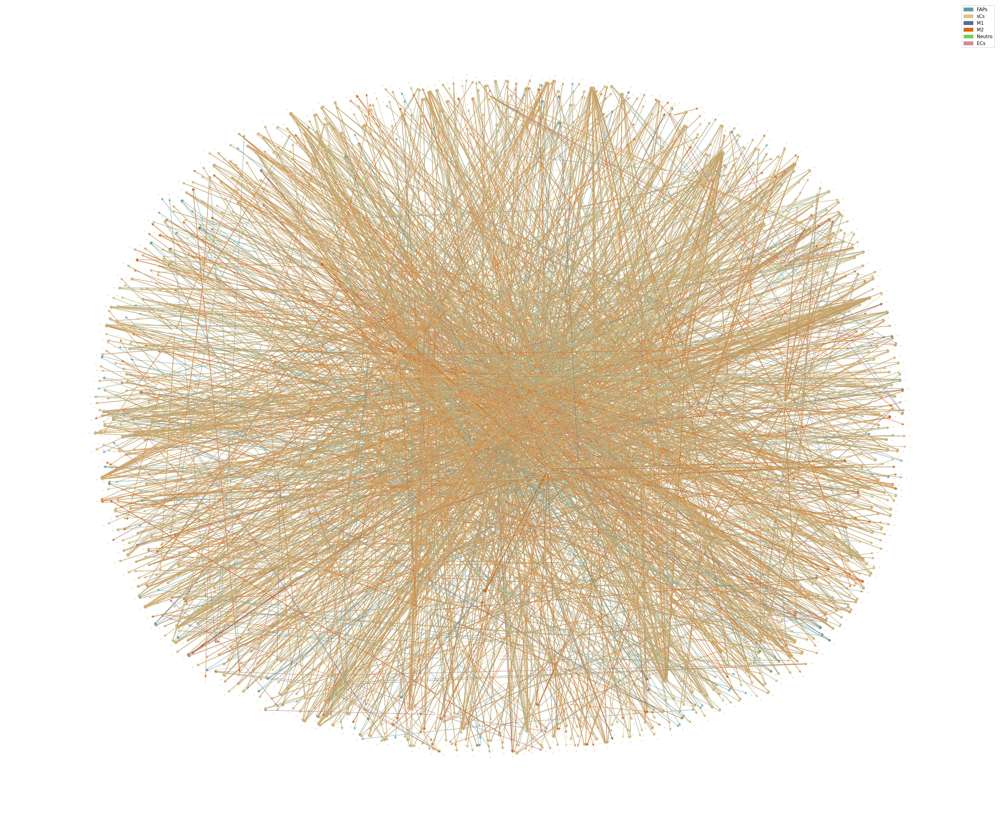

In [122]:
pos = nx.spring_layout(GY7)

fig = plt.figure (figsize=(30,25),dpi=150)
color_patches = []
for key, value in celltycolors.items():
    tmppatch = mpatches.Patch(color=value, label=key)
    color_patches.append(tmppatch)

nodes = nx.draw_networkx_nodes(GY7,
                              pos,
                               node_size = 2,
                              node_color = ccc, edgecolors = 'lightgray', 
                              alpha=0.7)
edges = nx.draw_networkx_edges(GY7,
                              pos,
                              edge_color = eee, alpha=0.7)
ax = plt.gca()
ax.set_axis_off()
fig.tight_layout()
plt.legend(handles=color_patches)

fig.savefig('YoungD7_all8000interactions.pdf', dpi=150)

EXTRACT CONNECTED COMPONENTS

In [139]:
# transform into undirected graph:
uGY7 = nx.Graph(GY7)

In [143]:
print([uGY7.number_of_nodes(),uGY7.number_of_edges()])

[2009, 8606]


In [140]:
len([ len(c) for c in (nx.connected_components(uGY7))])


74

In [141]:
cliques = list(nx.find_cliques(uGY7))

In [142]:
len(cliques)

8522

In [144]:
cliques

[['OgfrFAPs', 'PenkFAPs'],
 ['Col5a2sCs', 'Ddr1sCs'],
 ['Col5a2sCs', 'Ddr1FAPs'],
 ['Col5a2sCs', 'Ddr1M2'],
 ['Cntnap1FAPs', 'Rtn4ECs'],
 ['Cntnap1FAPs', 'Rtn4sCs'],
 ['Cntnap1FAPs', 'Rtn4M2'],
 ['Cntnap1FAPs', 'Rtn4FAPs'],
 ['Il1r2M2', 'Il1bM2'],
 ['Il1r2M2', 'Il1rnM2'],
 ['Il1r2M2', 'Il1bECs'],
 ['Il1r2M2', 'Il1aM2'],
 ['Ybx1FAPs', 'Notch1sCs'],
 ['Ybx1FAPs', 'Notch1ECs'],
 ['Ybx1FAPs', 'Notch1M2'],
 ['Ybx1FAPs', 'Notch1FAPs'],
 ['Cd46sCs', 'Jag1M2'],
 ['Cd46sCs', 'C3FAPs'],
 ['Cd46sCs', 'Jag1ECs'],
 ['Cd46sCs', 'C3M2'],
 ['Cd46sCs', 'C3sCs'],
 ['Cd46sCs', 'Jag1sCs'],
 ['Cd46sCs', 'Jag1FAPs'],
 ['Cd46sCs', 'C3ECs'],
 ['NppcsCs', 'Npr3sCs'],
 ['NppcsCs', 'Npr3FAPs'],
 ['NppcsCs', 'Npr2sCs'],
 ['NppcsCs', 'Npr2FAPs'],
 ['PtprbECs', 'PtnsCs'],
 ['PtprbECs', 'PtnFAPs'],
 ['PtprbECs', 'TncsCs'],
 ['PtprbECs', 'TncFAPs'],
 ['Anxa2FAPs', 'Tlr2M2'],
 ['Anxa2FAPs', 'Tlr2FAPs'],
 ['Anxa2FAPs', 'Robo4sCs'],
 ['Nt5esCs', 'Fn1M2'],
 ['Nt5esCs', 'Fn1FAPs'],
 ['Nt5esCs', 'Fn1sCs'],
 ['Nt5esCs', 'Fn